# Visualize Model Performance (Detailed)

In [1]:
from utils.data import build_dataset,build_xview_dataset, unwrap_collate_fn
from attrdict import AttrDict
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageDraw
from utils.fcos import fcos_resnet50_fpn
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from collections import OrderedDict
from tqdm import tqdm

In [2]:
TRAIN_DATA_DIR='determined-ai-xview-coco-dataset/val_sliced_no_neg/val_images_300_02/'

dataset, num_classes = build_xview_dataset(image_set='val',args=AttrDict({
                                                'data_dir':TRAIN_DATA_DIR,
                                                'backend':'aws',
                                                'masks': None,
                                                }))

PATHS:  {'train': ('determined-ai-xview-coco-dataset/val_sliced_no_neg/val_images_300_02/', '/tmp/train_sliced_no_neg/train_300_02.json'), 'val': ('determined-ai-xview-coco-dataset/val_sliced_no_neg/val_images_300_02/', '/tmp/val_sliced_no_neg/val_300_02.json')}
loading annotations into memory...
Done (t=1.11s)
creating index...
index created!
self.catIdtoCls:  {0: 1, 1: 2, 2: 3, 3: 4, 4: 5, 5: 6, 6: 7, 7: 8, 8: 9, 9: 10, 10: 11, 11: 12, 12: 13, 13: 14, 14: 15, 15: 16, 16: 17, 17: 18, 18: 19, 19: 20, 20: 21, 21: 22, 22: 23, 23: 24, 24: 25, 25: 26, 26: 27, 27: 28, 28: 29, 29: 30, 30: 31, 31: 32, 32: 33, 33: 34, 34: 35, 35: 36, 36: 37, 37: 38, 38: 39, 39: 40, 40: 41, 41: 42, 42: 43, 43: 44, 44: 45, 45: 46, 46: 47, 47: 48, 48: 49, 49: 50, 50: 51, 51: 52, 52: 53, 53: 54, 54: 55, 55: 56, 56: 57, 57: 58, 58: 59, 59: 60}


In [3]:
# dataset[0]

In [4]:
# {i:i+1 for i in dataset.coco.getCatIds()}

In [5]:
# img, ann = dataset[0]
# print(ann)
# print(img.shape)
# np.array(img, dtype=np.uint8).transpose(1,2,0).dtype

In [6]:
# img = Image.fromarray(np.array(img*255, dtype=np.uint8).transpose(1,2,0))
# draw = ImageDraw.Draw(img)
# for a in ann['boxes']:
#     x,y,x2,y2 = a.numpy()
#     # print( x,y,x2,y2)
#     draw.rectangle([x,y,x2,y2])
    
# plt.imshow(np.array(img)/255.)

In [7]:
# Load Model

In [8]:
def build_frcnn_model(num_classes):
    # load an detection model pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    model.min_size=800
    model.max_size=1333
    # RPN parameters
    model.rpn_pre_nms_top_n_train=2000
    model.rpn_pre_nms_top_n_test=1000
    model.rpn_post_nms_top_n_train=2000
    model.rpn_post_nms_top_n_test=1000
    model.rpn_nms_thresh=0.7
    model.rpn_fg_iou_thresh=0.7
    model.rpn_bg_iou_thresh=0.3
    model.rpn_batch_size_per_image=256
    model.rpn_positive_fraction=0.5
    model.rpn_score_thresh=0.0
    # Box parameters
    model.box_score_thresh=0.0
    model.box_nms_thresh=0.5
    model.box_detections_per_img=100
    model.box_fg_iou_thresh=0.5
    model.box_bg_iou_thresh=0.5
    model.box_batch_size_per_image=512
    model.box_positive_fraction=0.25
    return model

    return model

In [9]:
# ckpt = torch.load('/run/determined/workdir/xview-torchvision-coco/checkpoints/9b8d0d59-ba54-41b9-b570-5f878e1048dd/state_dict.pth',map_location='cpu')


In [10]:
# ckpt['models_state_dict'][0].items()

In [11]:
# state_dict = torch.load('myfile.pth.tar')
# create new OrderedDict that does not contain `module.`
def load_determined_state_dict(ckpt):
    '''
    Removes module from state dict keys as determined saves model in DataParallel format:
    https://discuss.pytorch.org/t/solved-keyerror-unexpected-key-module-encoder-embedding-weight-in-state-dict/1686/4
    '''
    new_state_dict = OrderedDict()
    for k, v in ckpt['models_state_dict'][0].items():
        name = k[7:] # remove `module.`
        new_state_dict[name] = v
    return new_state_dict
# load params
# model.load_state_dict(new_state_dict)

In [12]:
# new_state_dict

In [13]:
# model = fcos_resnet50_fpn(pretrained=False,num_classes=61)
model=build_frcnn_model(num_classes=61)
# model.load_state_dict(torch.load('model_30_ap.pth').state_dict())
# /run/determined/workdir/xview-torchvision-coco/checkpoints/9b8d0d59-ba54-41b9-b570-5f878e1048dd
checkpoint = '5bf118a9-6a5c-459f-ba3d-df9afd94d540'
# ckpt_path = '/run/determined/workdir/xview-torchvision-coco/checkpoints/checkpoints/f5ff0495-e6e0-4a71-ae9a-aa6ff2ada109/state_dict.pth'
# ckpt = torch.load(ckpt_path,map_location='cpu')
# print(ckpt['models_state_dict'])
ckpt = torch.load(f'/run/determined/workdir/xview-torchvision-coco/checkpoints/{checkpoint}/state_dict.pth',map_location='cpu')
m_ckpt = load_determined_state_dict(ckpt)
# print(m_ckpt)
model.load_state_dict(m_ckpt)
model.to('cuda')
model.eval()
print("Done Loading")

/opt/conda/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Done Loading


* Length of train_300_02.json (batch size 16): 1288
* Length of val_300_02.json (batch size 16): 448

In [14]:
# # import torch
# # ckpt.module
# # Check number of batches
# TRAIN_DATA_DIR='determined-ai-xview-coco-dataset/train_sliced_no_neg/train_images_300_02/'

# datasety, num_classes = build_xview_dataset(image_set='train',args=AttrDict({
#                                                 'data_dir':TRAIN_DATA_DIR,
#                                                 'backend':'aws',
#                                                 'masks': None,
#                                                 }))
# data_loader_test = torch.utils.data.DataLoader(
#         datasety, batch_size=16, sampler=None, num_workers=0, collate_fn=unwrap_collate_fn)
# print("Len of dataset: ",len(data_loader_test))

# TRAIN_DATA_DIR='determined-ai-xview-coco-dataset/val_sliced_no_neg/val_images_300_02/'

# datasety, num_classes = build_xview_dataset(image_set='val',args=AttrDict({
#                                                 'data_dir':TRAIN_DATA_DIR,
#                                                 'backend':'aws',
#                                                 'masks': None,
#                                                 }))
# data_loader_test = torch.utils.data.DataLoader(
#         datasety, batch_size=16, sampler=None, num_workers=0, collate_fn=unwrap_collate_fn)
# print("Len of dataset: ",len(data_loader_test))

In [15]:
def collate_fn(batch):
    return tuple(list(zip(*batch)))
data_loader_test = torch.utils.data.DataLoader(
        dataset, batch_size=1, sampler=None, num_workers=0, collate_fn=collate_fn)

In [16]:
# images_t, targets_t= list(data_loader_test)[0]

In [17]:
# images_t[0].shape

In [18]:
# targets_t[0]

In [19]:
# res

In [41]:
# from time import time
def visualize_pred(inv_tensor,res,targets_t):
    '''
    '''
    img = Image.fromarray((255.*inv_tensor.cpu().permute((1,2,0)).numpy()).astype(np.uint8))
    draw = ImageDraw.Draw(img)
    # draw ground truth
    print("Num GT Boxes: ",targets_t[0]['boxes'].shape[0])
    for ind,(b,l) in enumerate(zip(targets_t[0]['boxes'],targets_t[0]['labels'])):
        # print(b.detach().numpy(), s.detach().numpy())
        x,y,x2,y2 = b.detach().numpy()
        # print( x,y,x2,y2,l.item())
        draw.rectangle([x,y,x2,y2],fill=None,outline=(0,255,0))
        draw.text([x,y-10],"{}".format(l),fill=None,outline=(0,255,0))

    idx = list(res.keys())[0]
    print("Num Pred Boxes: ",res[idx]['boxes'].shape[0])
    for ind,(b,s,l) in enumerate(zip(res[idx]['boxes'],res[idx]['scores'],res[idx]['labels'])):
        # print(b.detach().numpy(), s.detach().numpy())
        x,y,x2,y2 = b.detach().numpy()
        # print( x,y,x2,y2,s.item(),l.item())
        draw.rectangle([x,y,x2,y2],fill=None,outline=(255,0,0))
        draw.text([x,y-10],"{}".format(l),fill=None,outline=(255,0,0))



    plt.imshow(img)
def predict(x,model,images_t,targets_t):
    '''
    '''
    cpu_device = torch.device('cpu')
    device = torch.device('cuda')
    images_t = list(image.to(device) for image in images_t)
    outputs = model(images_t)
    # print(x,outputs)
    outputss = []
    for t in outputs:
        outputss.append({k: v.to(cpu_device) for k, v in t.items()})
    # model_time = time.time() - model_time
    res = {target["image_id"].item(): output for target, output in zip(targets_t, outputss)}
    visualize_pred(images_t[0],res,targets_t)
    return res
def predict2(model,images_t,targets_t):
    '''
    '''
    cpu_device = torch.device('cuda')
    outputs = model(images_t)
    # print(outputs)
    outputss = []
    for t in outputs:
        outputss.append({k: v.to(cpu_device) for k, v in t.items()})
    # model_time = time.time() - model_time
    res = {target["image_id"].item(): output for target, output in zip(targets_t, outputss)}
    # visualize_pred(images_t[0],res,targets_t)
    return img, res

In [31]:
inds_that_have_boxes = []
for ind,(im,targets) in tqdm(enumerate(list(data_loader_test)),total=len(list(data_loader_test))):
    # print(ind,targets)
    if targets[0]['boxes'].shape[0]>0:
        # print(targets[0]['boxes'].shape[0])
        # print(ind,targets)
        inds_that_have_boxes.append(ind)
    # break

100%|██████████| 7166/7166 [00:00<00:00, 95376.51it/s]


In [22]:
# inds_that_have_boxes

In [23]:
next(model.parameters()).is_cuda 

True

In [24]:
# # Imports for JupyterLite
# try:
#     import piplite
#     await piplite.install(['ipywidgets'])
# except ImportError:
#     pass

In [25]:
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [26]:
# def f(x):
#     return x

In [27]:
# interact(f, x=10);

In [28]:
def interactive_test(x):
    images_t, targets_t= list(data_loader_test)[inds_that_have_boxes[x]]
    predict(x,model,images_t,targets_t)

In [35]:
interactive_test(2)

In [42]:
interact(interactive_test,x=widgets.IntSlider(min=0, max=len(inds_that_have_boxes), step=1,value=2))

interactive(children=(IntSlider(value=2, description='x', max=7166), Output()), _dom_classes=('widget-interact…

<function __main__.interactive_test(x)>

# SAHI

In [43]:
# import required functions, classes
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction, predict, get_prediction
from sahi.utils.file import download_from_url
from sahi.utils.cv import read_image
from IPython.display import Image

In [44]:
# model

In [45]:
from pycocotools.coco import COCO

In [46]:
# coco = COCO('/tmp/val_sliced_no_neg/val.json')


In [47]:
# cat_mapping
# !pwd

In [48]:
from pycocotools.coco import COCO
coco = COCO('/run/determined/workdir/val.json')
cat_mapping = {0:'background'}
cat_mapping.update({str(int(i['id'])+1):i['name'] for i in coco.cats.values()})
# im

loading annotations into memory...
Done (t=0.47s)
creating index...
index created!


In [49]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='torchvision',
    model=model,
    confidence_threshold=0.5,
    image_size=800,
    device="cuda", # or "cuda:0"
    load_at_init=True,
    category_mapping=cat_mapping
)

In [50]:
# {i:i for i in range(61)}

In [51]:
result = get_sliced_prediction(
    "/run/determined/workdir/1065.png",
    detection_model,
    slice_height = 320,
    slice_width = 320,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2,
    verbose=2
)

Performing prediction on 143 number of slices.


/opt/conda/lib/python3.8/site-packages/sahi/utils/torch.py:31: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:178.)
  img = torch.from_numpy(img).float()


Slicing performed in 0.3978617191314697 seconds.
Prediction performed in 38.64029598236084 seconds.


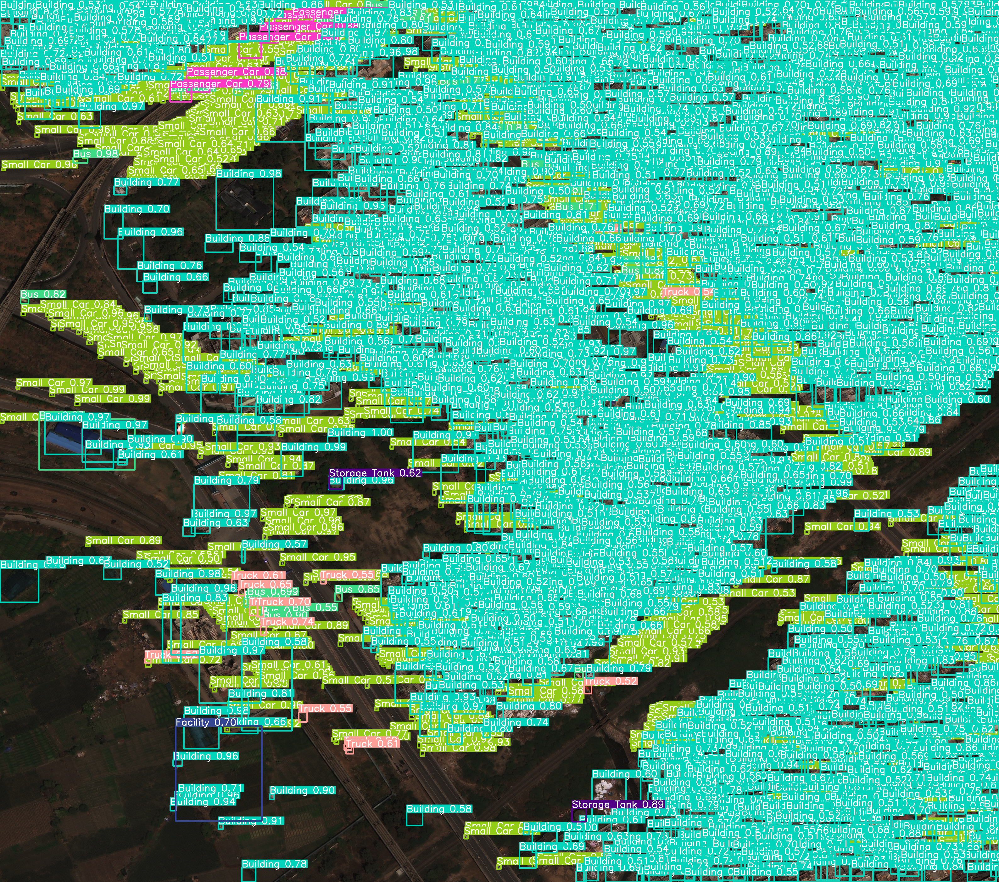

In [52]:
result.export_visuals(export_dir="/run/determined/workdir/")

Image("/run/determined/workdir/prediction_visual.png")

loading annotations into memory...
Done (t=0.57s)
creating index...
index created!


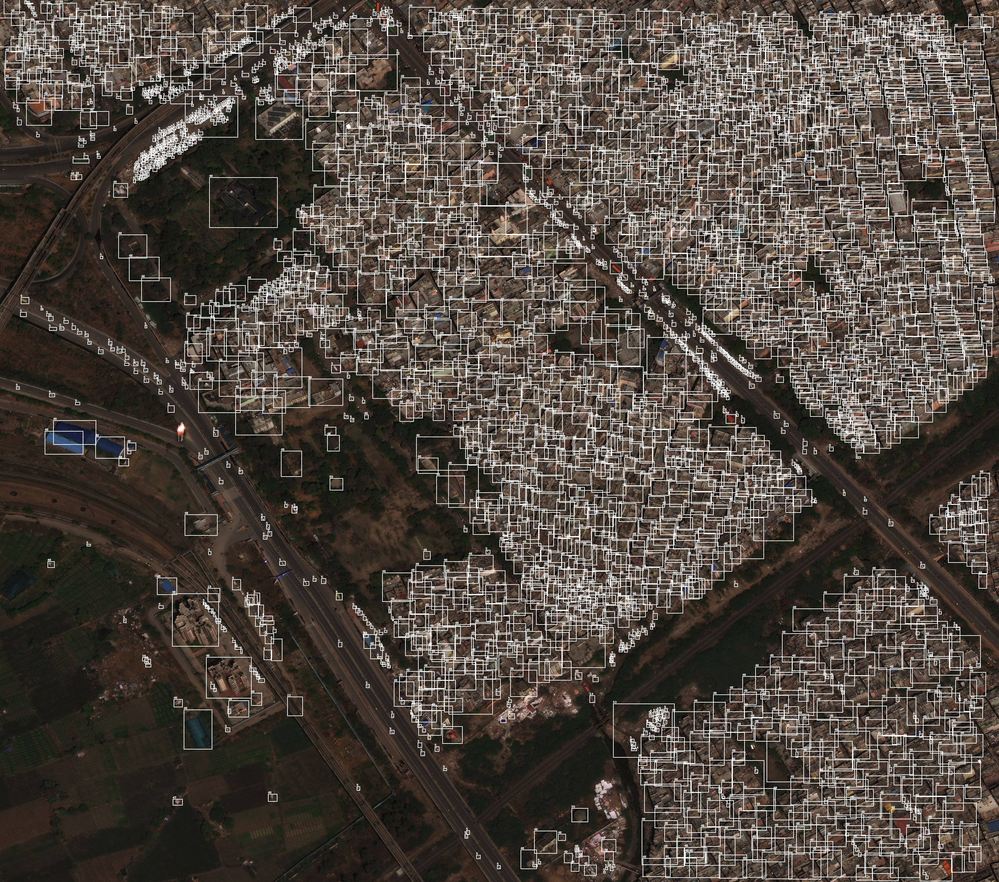

In [53]:
# Load ground truth coco annotations
coco = COCO('/run/determined/workdir/val.json')
cat_mapping = {0:'background'}
cat_mapping.update({str(int(i['id'])+1):i['name'] for i in coco.cats.values()})
# coco.imgs[1]
# get specific annotation ids
ann_ids = coco.getAnnIds([1])
anns = [coco.anns[a] for a in ann_ids]
from PIL import Image, ImageDraw
# im = Image.open('/run/determined/workdir/prediction_visual.png')
im = Image.open('/run/determined/workdir/1065.png')
draw = ImageDraw.Draw(im)
for a in anns:
    x,y,w,h = a['bbox']
    l = a['category_id']
    x2 = x+w
    y2 = y+h
    # print(x,y,x2,y2,l)
    draw.rectangle([x,y,x2,y2],outline=(255,255,255),fill=None,width=2)
    draw.text([x,y-10],"{}".format(l))
im

In [54]:
# Image("/run/determined/workdir/prediction_visual.png")

In [95]:
# Inspect dataset

In [96]:
!ls /tmp/train_sliced_no_neg

train_300_02_1k.json


In [ ]:
coco = COCO('/run/determined/workdir/val.json')